In [65]:
# For running inference on the TF-Hub module.
import tensorflow as tf
tf.compat.v1.enable_eager_execution()
import tensorflow_hub as hub

# For downloading the image.
import matplotlib.pyplot as plt
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

# For drawing onto the image.
import os
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps

# For measuring the inference time.
import time

# Print Tensorflow version
print(tf.__version__)

# Check available GPU devices.
print("The following GPU devices are available: %s" % tf.test.gpu_device_name())

2.5.0
The following GPU devices are available: 


In [71]:
def display_image(image):
    fig = plt.figure(figsize=(20, 15))
    plt.grid(False)
    plt.imshow(image)


def download_and_resize_image(url, new_width=256, new_height=256,
                              display=False):
    _, filename = tempfile.mkstemp(suffix=".jpg")
    response = urlopen(url)
    image_data = response.read()
    image_data = BytesIO(image_data)
    pil_image = Image.open(image_data)
    pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
    pil_image_rgb = pil_image.convert("RGB")
    pil_image_rgb.save(filename, format="JPEG", quality=90)
    print("Image downloaded to %s." % filename)
    if display:
        display_image(pil_image)
    return filename


def draw_bounding_box_on_image(image,
                               ymin,
                               xmin,
                               ymax,
                               xmax,
                               color,
                               font,
                               thickness=4,
                               display_str_list=()):
    """Adds a bounding box to an image."""
    draw = ImageDraw.Draw(image)
    im_width, im_height = image.size
    (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                ymin * im_height, ymax * im_height)
    draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
            (left, top)],
            width=thickness,
            fill=color)

    # If the total height of the display strings added to the top of the bounding
    # box exceeds the top of the image, stack the strings below the bounding box
    # instead of above.
    display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
    # Each display_str has a top and bottom margin of 0.05x.
    total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

    if top > total_display_str_height:
        text_bottom = top
    else:
        text_bottom = top + total_display_str_height
    # Reverse list and print from bottom to top.
    for display_str in display_str_list[::-1]:
        text_width, text_height = font.getsize(display_str)
        margin = np.ceil(0.05 * text_height)
        draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                        (left + text_width, text_bottom)],
                    fill=color)
        draw.text((left + margin, text_bottom - text_height - margin),
                display_str,
                fill="black",
                font=font)
        text_bottom -= text_height - 2 * margin


def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.1):
    """Overlay labeled boxes on an image with formatted scores and label names."""
    colors = list(ImageColor.colormap.values())

    font = ImageFont.load_default()

    for i in range(min(boxes.shape[0], max_boxes)):
        if scores[i] >= min_score:
            ymin, xmin, ymax, xmax = tuple(boxes[i])
        
            display_str = "{}: {}%".format(class_names[i].decode("ascii"), int(100 * scores[i]))
            color = colors[hash(class_names[i]) % len(colors)]
            image_pil = Image.fromarray(np.uint8(image)).convert("RGB")
    
            draw_bounding_box_on_image(
                image_pil,
                ymin,
                xmin,
                ymax,
                xmax,
                color,
                font,
                display_str_list=[display_str])
            np.copyto(image, np.array(image_pil))
    return image

In [46]:
detector = hub.load("https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1")
# detector = hub.load("https://tfhub.dev/google/object_detection/mobile_object_localizer_v1/1")

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [47]:
model_detector = detector.signatures['default']

Image downloaded to C:\Users\Mobis\AppData\Local\Temp\tmpk0ydhs22.jpg.


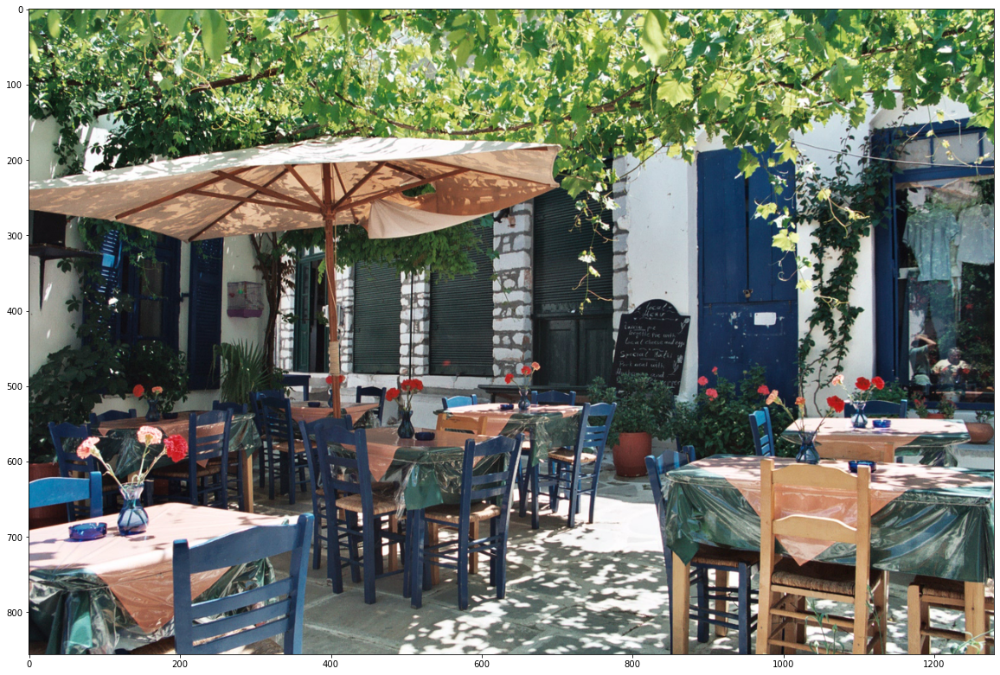

In [48]:
# By Heiko Gorski, Source: https://commons.wikimedia.org/wiki/File:Naxos_Taverna.jpg
image_url = "https://upload.wikimedia.org/wikipedia/commons/6/60/Naxos_Taverna.jpg" 
downloaded_image_path = download_and_resize_image(image_url, 1280, 856, True)

In [43]:
def load_img(path):
  img = tf.io.read_file(path)
  img = tf.image.decode_jpeg(img, channels=3)
  return img

In [54]:
def run_detector(detector, path):
  img = load_img(path)

  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
  start_time = time.time()
  result = model_detector(converted_img)
  end_time = time.time()

  result = {key:value.numpy() for key,value in result.items()}

  print("Found %d objects." % len(result["detection_scores"]))
  print("Inference time: ", end_time-start_time)

  image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"])

  display_image(image_with_boxes)

Found 100 objects.
Inference time:  0.1326436996459961
Font not found, using default font.


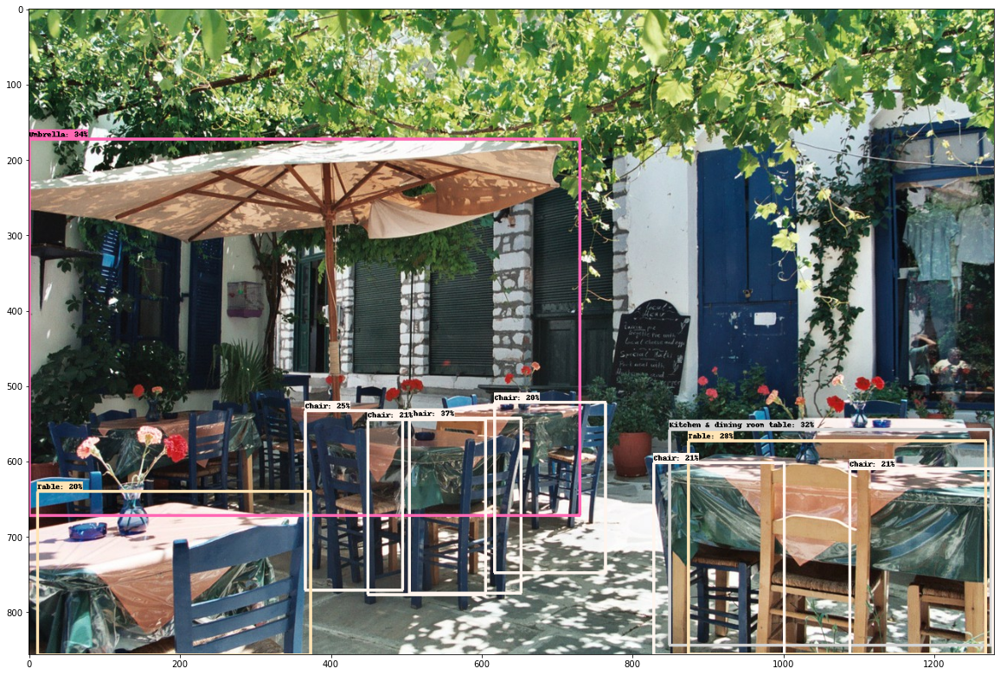

In [55]:
run_detector(detector, downloaded_image_path)

In [51]:
img = load_img(downloaded_image_path)

converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]

result = model_detector(converted_img)


In [52]:
result['num_detections'].numpy()

KeyError: 'num_detections'

In [53]:
result

{'detection_class_names': <tf.Tensor: shape=(100,), dtype=string, numpy=
 array([b'/m/01mzpv', b'/m/0hnnb', b'/m/0h8n5zk', b'/m/04bcr3',
        b'/m/01mzpv', b'/m/01mzpv', b'/m/01mzpv', b'/m/01mzpv',
        b'/m/01mzpv', b'/m/04bcr3', b'/m/01mzpv', b'/m/07j7r', b'/m/07j7r',
        b'/m/01mzpv', b'/m/07j7r', b'/m/01mzpv', b'/m/07j7r', b'/m/07j7r',
        b'/m/07j7r', b'/m/07j7r', b'/m/07j7r', b'/m/07j7r', b'/m/01mzpv',
        b'/m/01mzpv', b'/m/0c9ph5', b'/m/07j7r', b'/m/07j7r', b'/m/0c9ph5',
        b'/m/0hnnb', b'/m/07j7r', b'/m/07j7r', b'/m/07j7r', b'/m/07j7r',
        b'/m/04m6gz', b'/m/04bcr3', b'/m/07j7r', b'/m/07j7r', b'/m/07j7r',
        b'/m/04bcr3', b'/m/07j7r', b'/m/07j7r', b'/m/0c9ph5', b'/m/04bcr3',
        b'/m/07j7r', b'/m/07j7r', b'/m/07j7r', b'/m/07j7r', b'/m/07j7r',
        b'/m/07j7r', b'/m/01mzpv', b'/m/07j7r', b'/m/0c9ph5', b'/m/04bcr3',
        b'/m/07j7r', b'/m/07j7r', b'/m/01mzpv', b'/m/07j7r', b'/m/01mzpv',
        b'/m/07j7r', b'/m/07j7r', b'/m/07j7r', b'/

In [15]:
image_urls = [
  # Source: https://commons.wikimedia.org/wiki/File:The_Coleoptera_of_the_British_islands_(Plate_125)_(8592917784).jpg
  "https://upload.wikimedia.org/wikipedia/commons/1/1b/The_Coleoptera_of_the_British_islands_%28Plate_125%29_%288592917784%29.jpg",
  # By Américo Toledano, Source: https://commons.wikimedia.org/wiki/File:Biblioteca_Maim%C3%B3nides,_Campus_Universitario_de_Rabanales_007.jpg
  "https://upload.wikimedia.org/wikipedia/commons/thumb/0/0d/Biblioteca_Maim%C3%B3nides%2C_Campus_Universitario_de_Rabanales_007.jpg/1024px-Biblioteca_Maim%C3%B3nides%2C_Campus_Universitario_de_Rabanales_007.jpg",
  # Source: https://commons.wikimedia.org/wiki/File:The_smaller_British_birds_(8053836633).jpg
  "https://upload.wikimedia.org/wikipedia/commons/0/09/The_smaller_British_birds_%288053836633%29.jpg",
  ]

def detect_img(image_url):
  start_time = time.time()
  image_path = download_and_resize_image(image_url, 640, 480)
  run_detector(detector, image_path)
  end_time = time.time()
  print("Inference time:",end_time-start_time)

Image downloaded to C:\Users\Mobis\AppData\Local\Temp\tmpruoipizg.jpg.
Found 100 objects.
Inference time:  0.09973287582397461
Font not found, using default font.
Inference time: 1.005274772644043


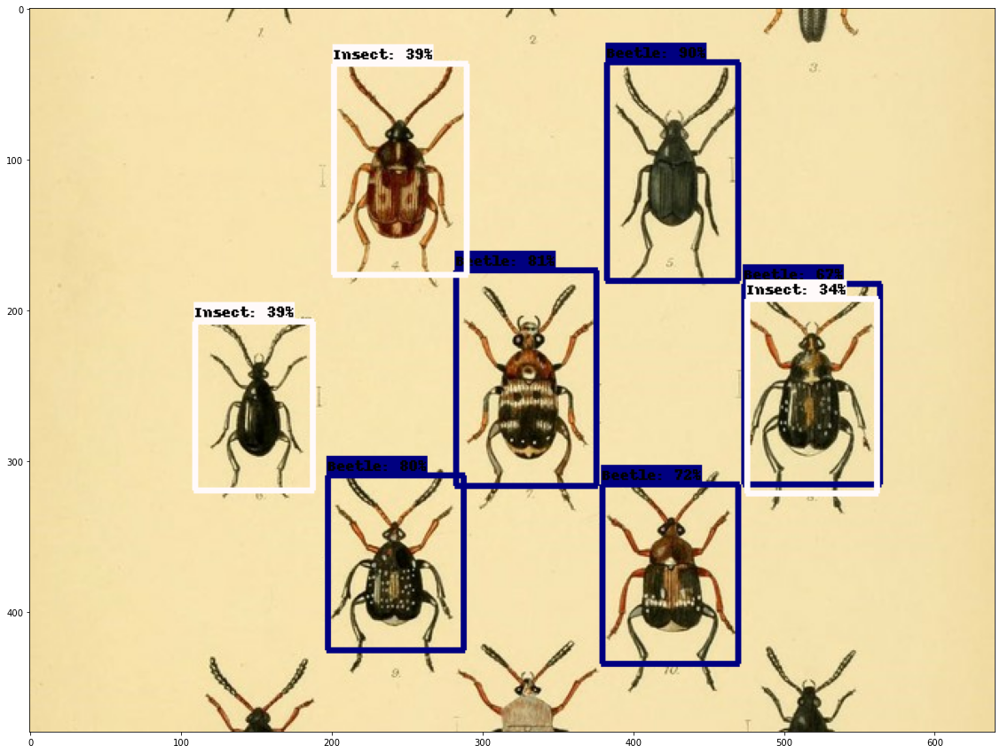

In [16]:
detect_img(image_urls[0])

Image downloaded to C:\Users\Mobis\AppData\Local\Temp\tmp5a6t_wej.jpg.
Found 100 objects.
Inference time:  0.10172748565673828
Font not found, using default font.
Inference time: 1.997624158859253


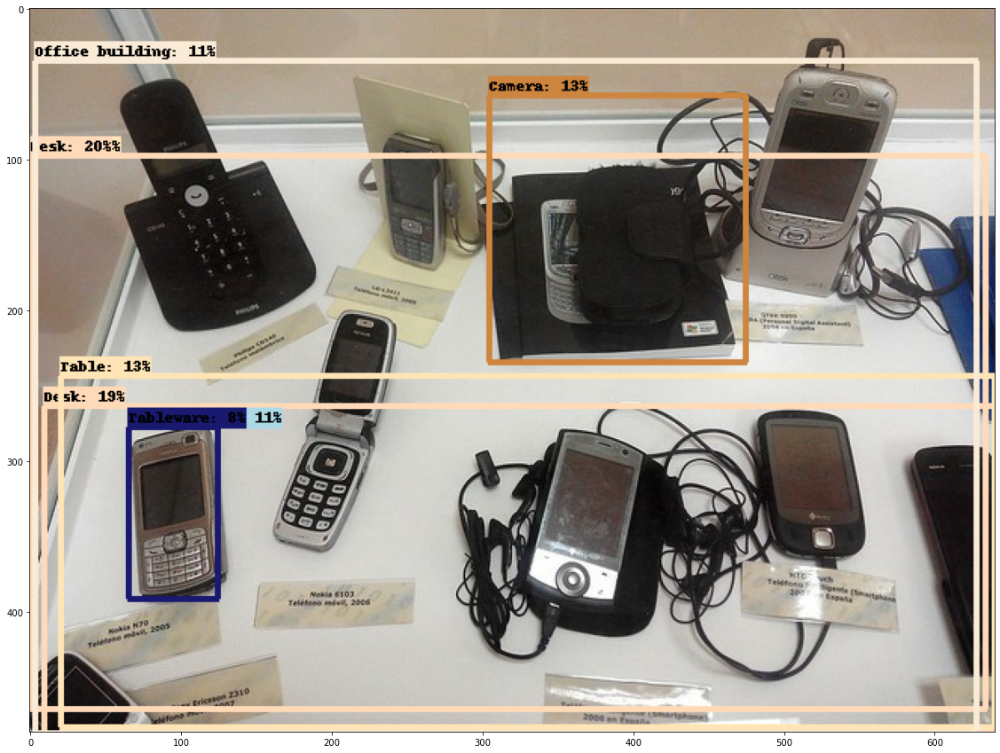

In [18]:
detect_img(image_urls[1])

Image downloaded to C:\Users\Mobis\AppData\Local\Temp\tmpaugmzn7k.jpg.
Found 100 objects.
Inference time:  0.09325575828552246
Font not found, using default font.
Inference time: 1.1643128395080566


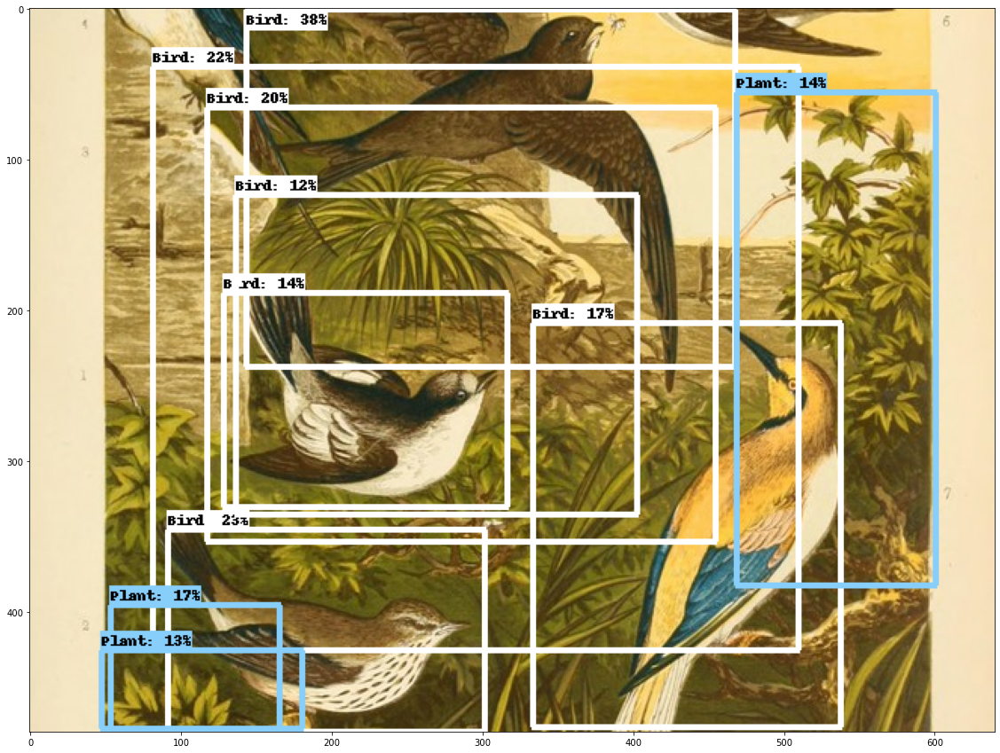

In [20]:
detect_img(image_urls[2])

Found 100 objects.
Inference time:  0.13880443572998047
Font not found, using default font.


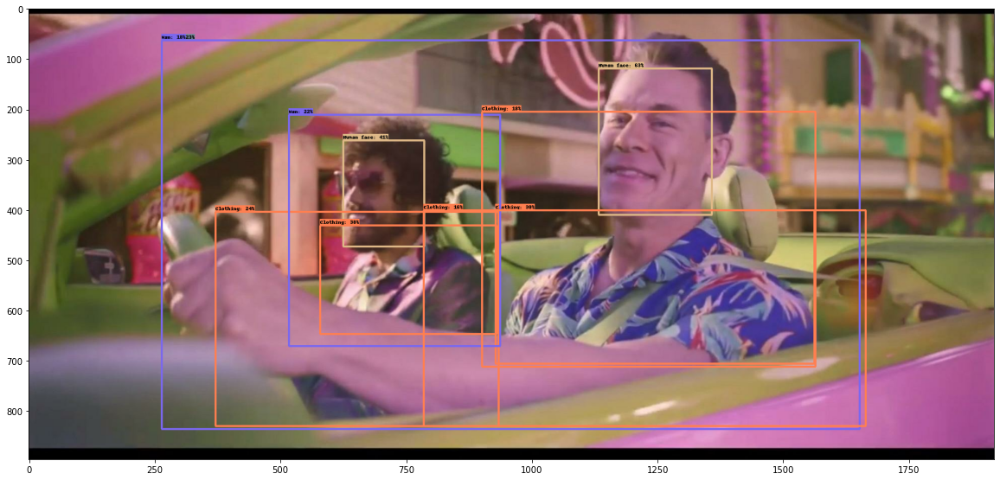

In [70]:
img_path = "C://workroom//learn_opencv//models//mtn-dew-commrcial_mp4-60_jpg.rf.8bf6ee5956ed039b9c90ac239e7f3bd5.jpg"
run_detector(model_detector, img_path)

In [67]:
images_list_uno = os.listdir("C://workroom//learn_opencv//models//test")

Found 100 objects.
Inference time:  0.1675729751586914
Found 100 objects.
Inference time:  0.1246650218963623
Found 100 objects.
Inference time:  0.10372018814086914
Found 100 objects.
Inference time:  0.10172843933105469
Found 100 objects.
Inference time:  0.18858623504638672
Found 100 objects.
Inference time:  0.1491076946258545
Found 100 objects.
Inference time:  0.11619234085083008
Found 100 objects.
Inference time:  0.10220098495483398
Found 100 objects.
Inference time:  0.10571527481079102
Found 100 objects.
Inference time:  0.10771036148071289


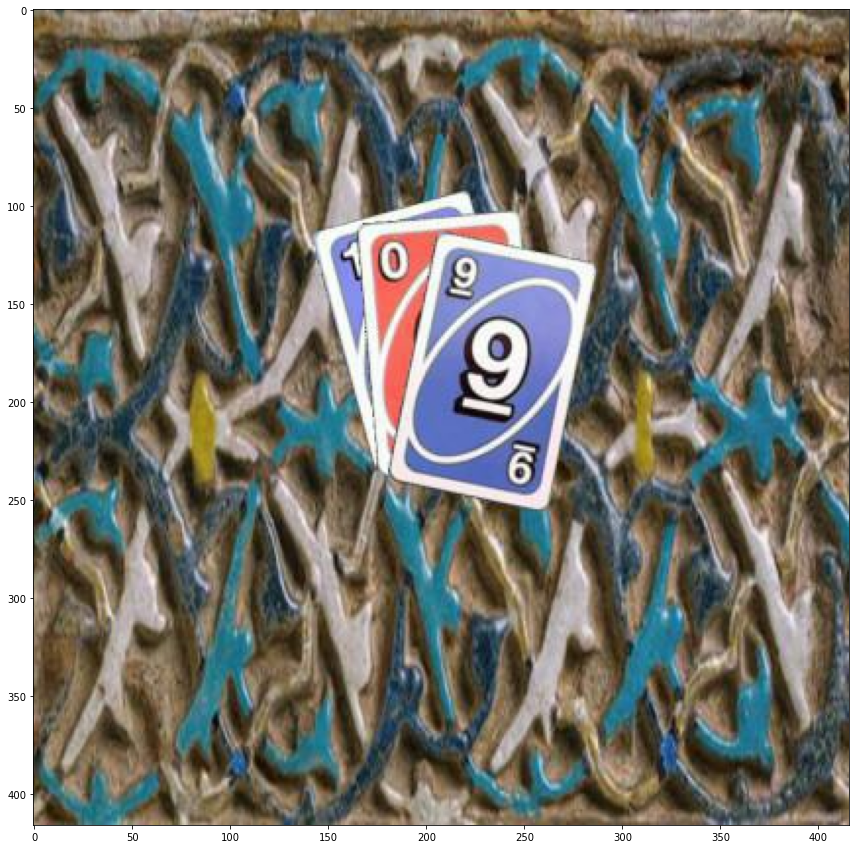

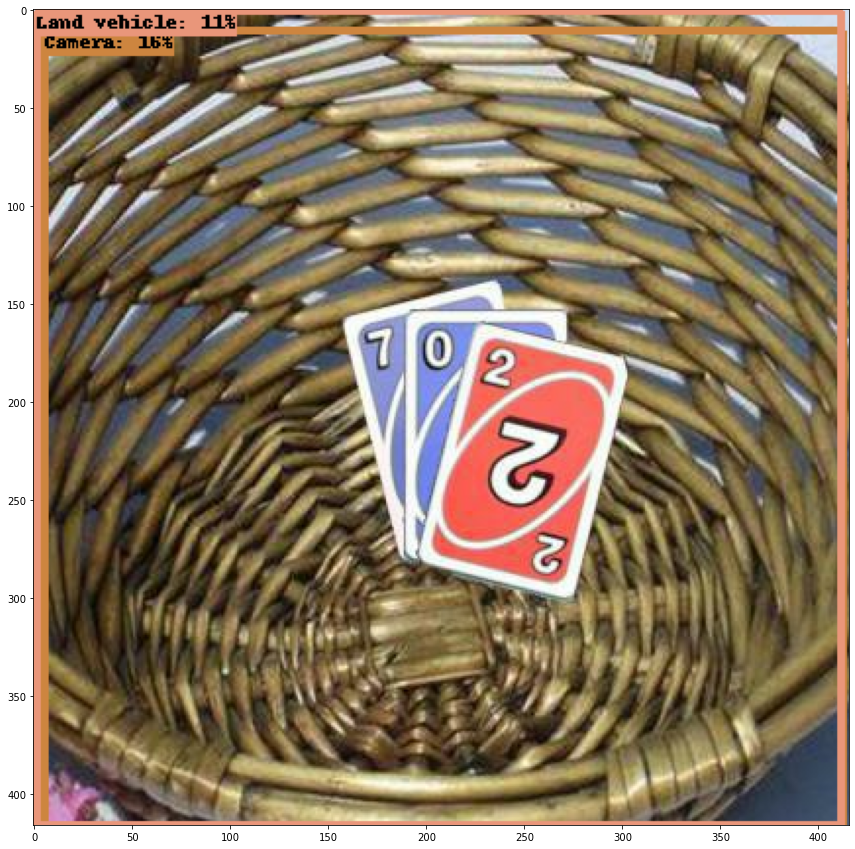

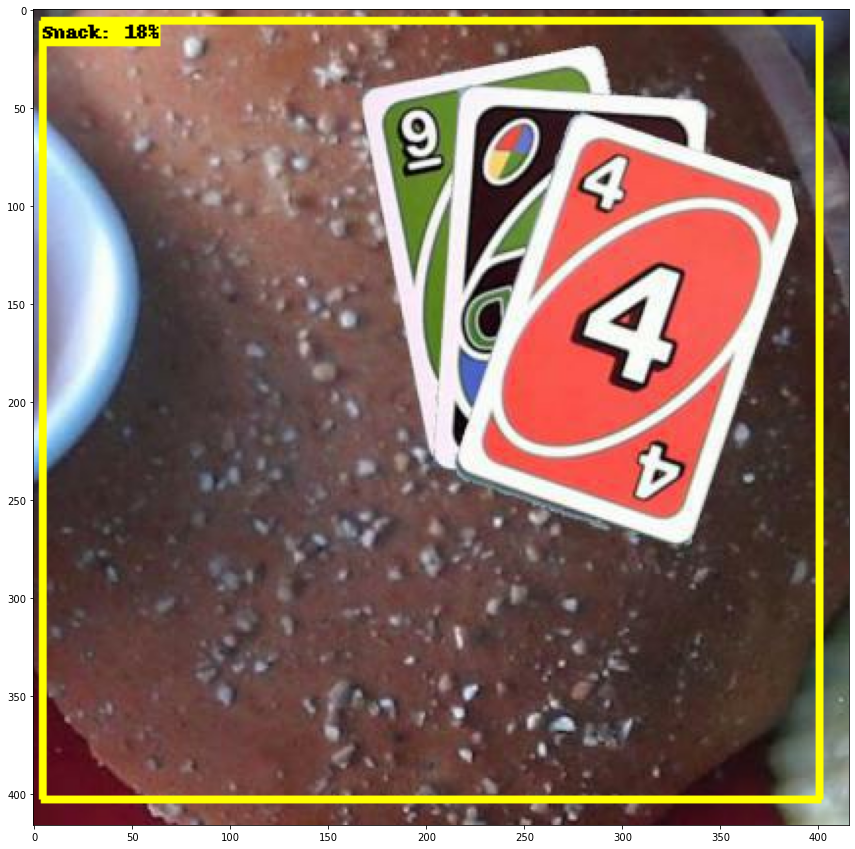

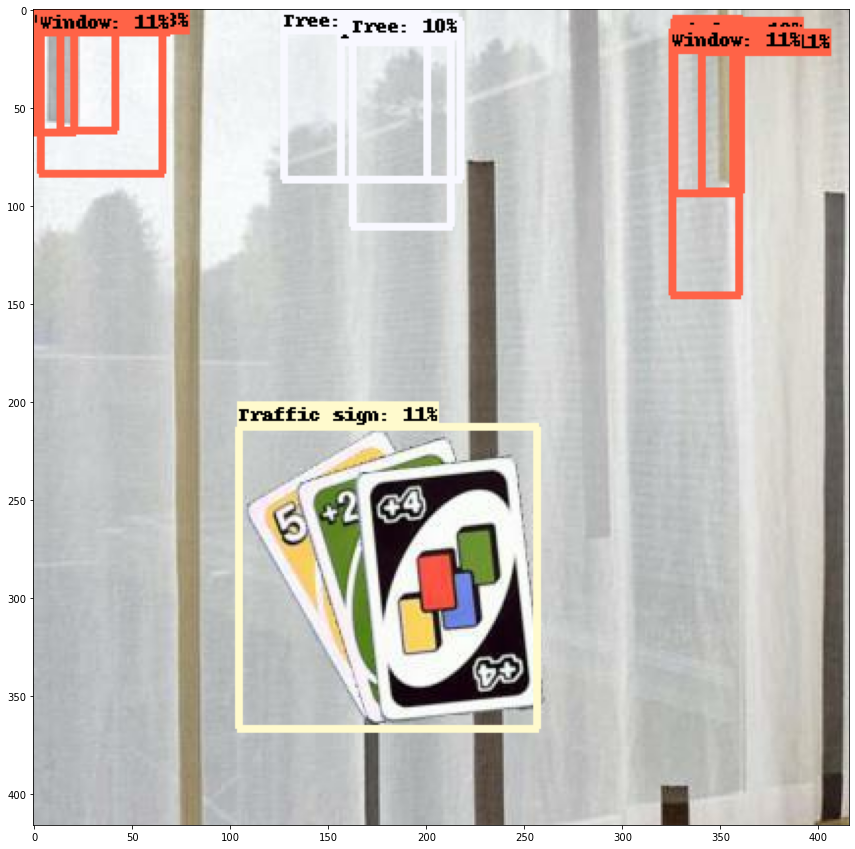

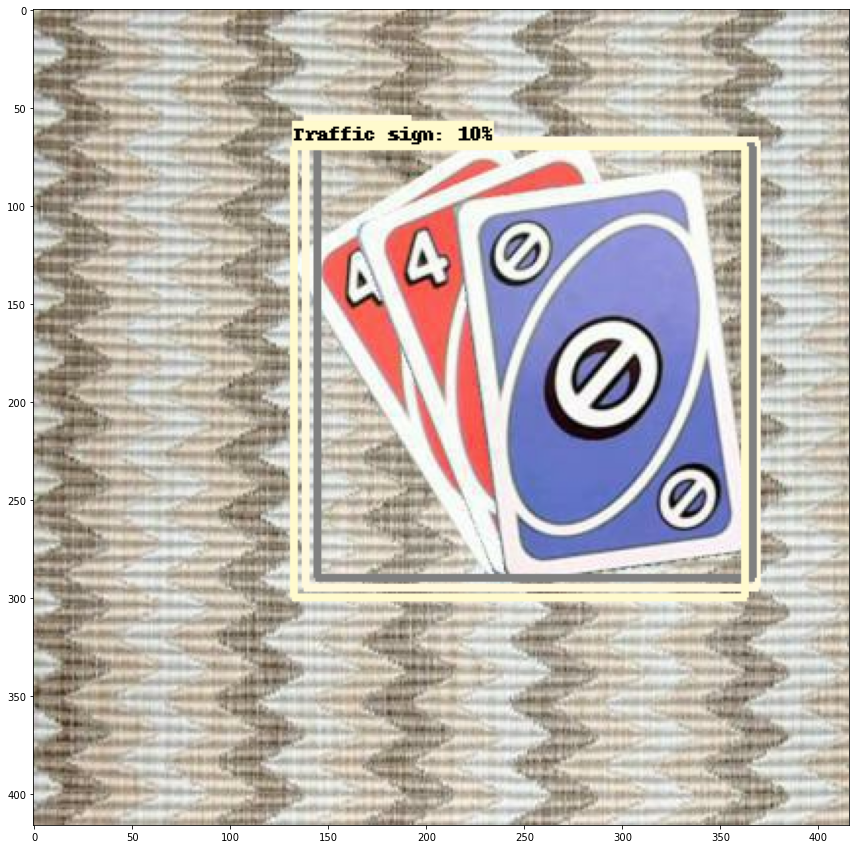

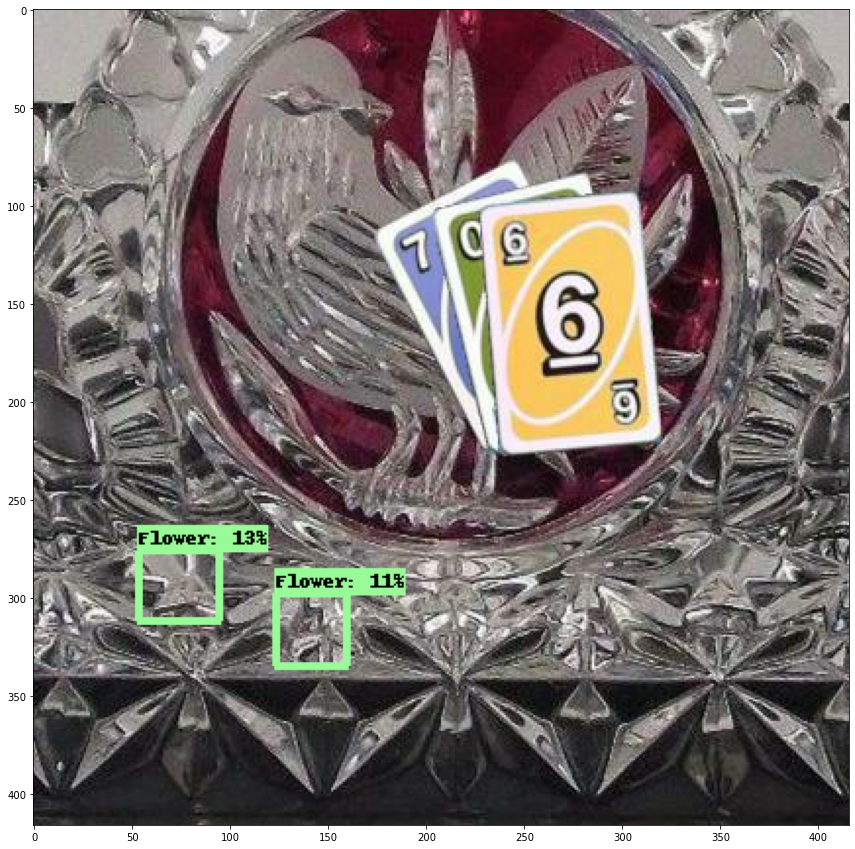

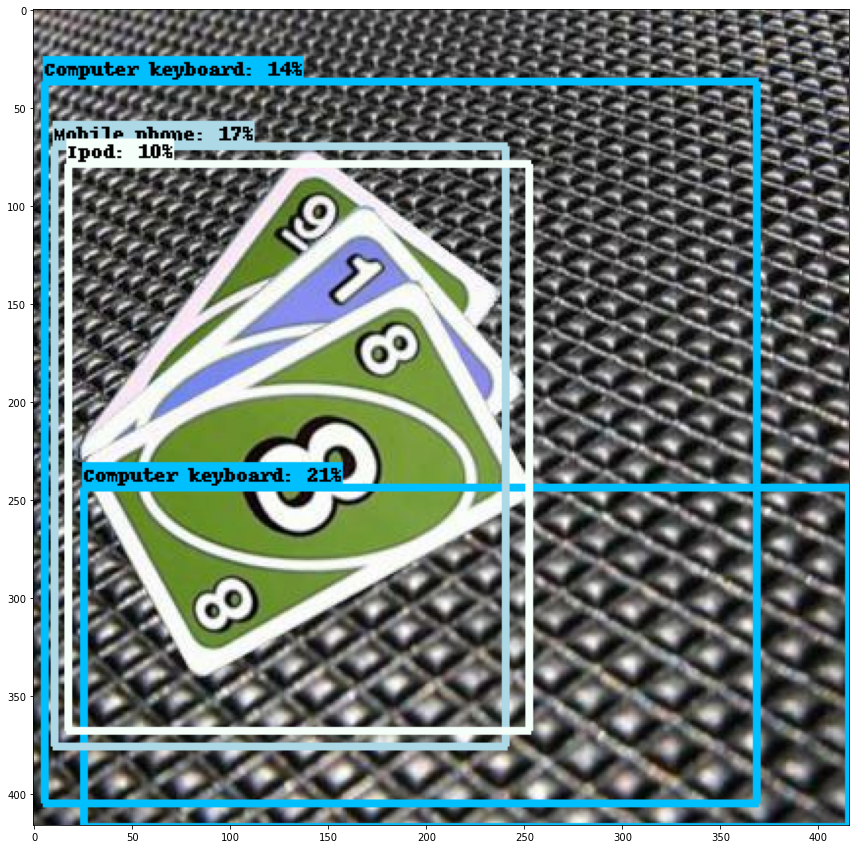

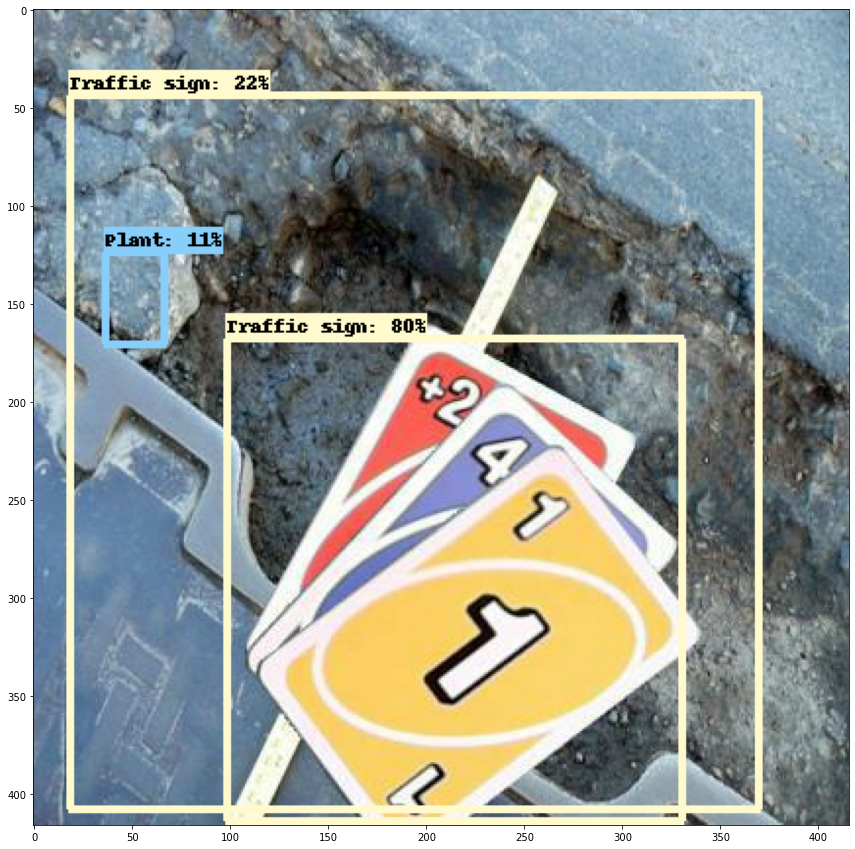

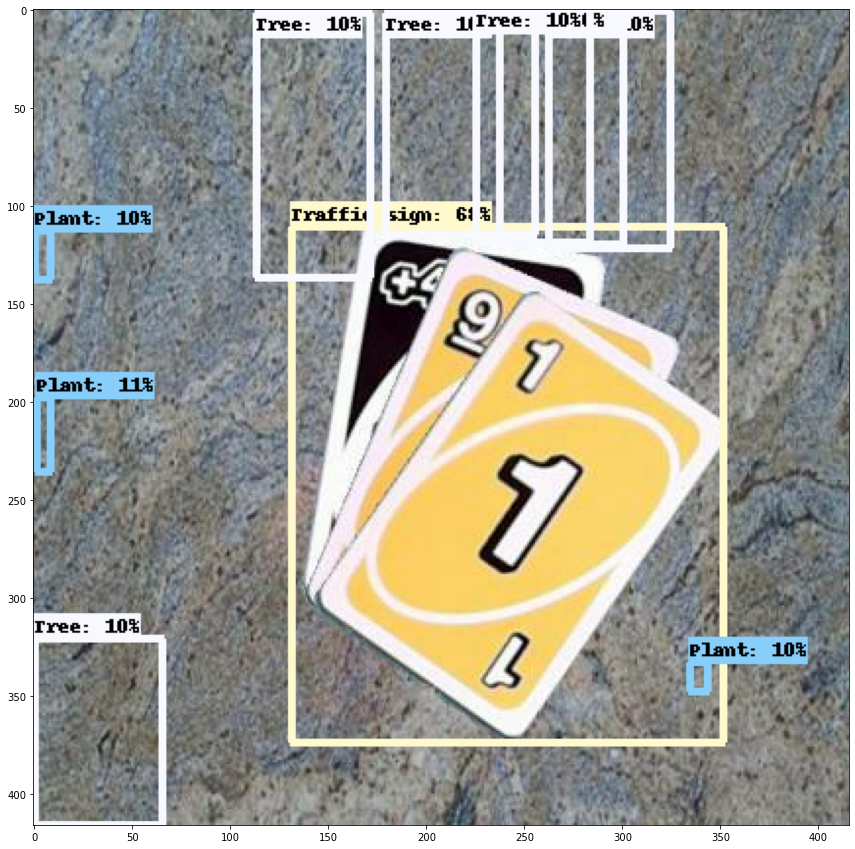

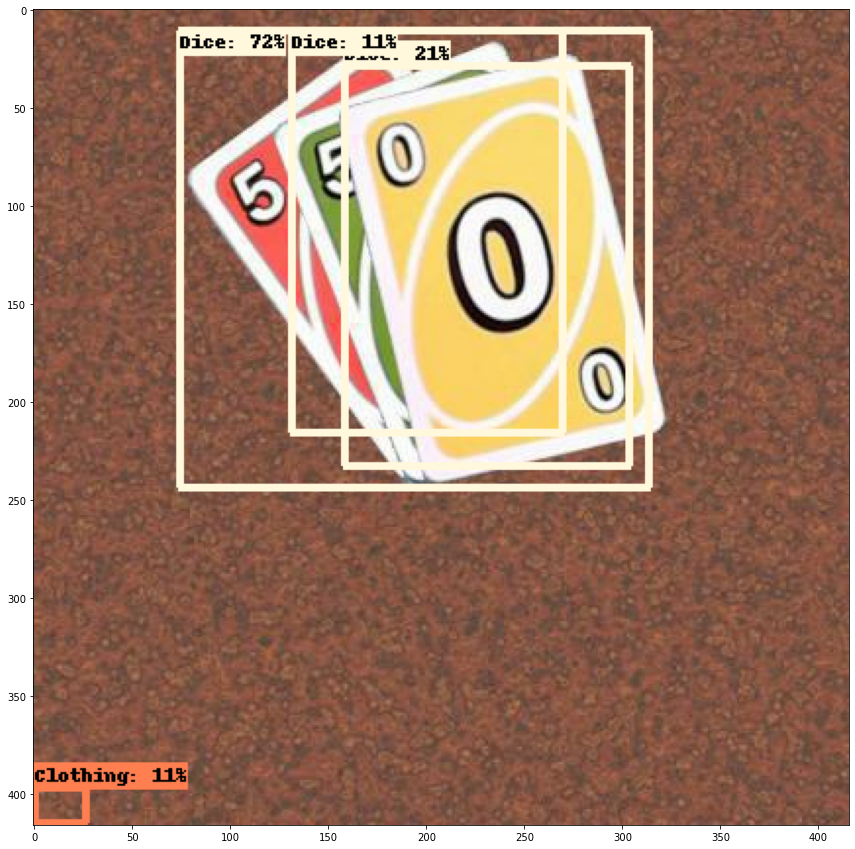

In [72]:
for i in range(10):
    run_detector(model_detector, os.path.join("C://workroom//learn_opencv//models//test", images_list_uno[i]))